# Velib - Activity analysis before and during the first lockdown in Paris


by Lara-Anna Wagner

# Table of Contents

0. Introduction
1. Research Question
2. Dataset
3. Data Analysis
4. Conclusions


# 0. Introduction 

In the following, I will analyze the Velib dataset, which is openly accessible on the Paris Data website. I was especially interested in working on this dataset to analyze activities before vs. during the COVID lockdown that took place for the first time starting the 18th of March. 

My initial assumption was that Velib was little used during that time, as people have been told to stay in quarantine. But we know that some exceptions have been made (certain professions, aiding people, groceries, sports etc..). Besides, people favored using a bike over the metro due to the spreading of bacteria. Therefore to get a better understanding of the collective behavior and how much Velib was used before and during quarantine, I decided to work on this dataset, abnalysing the period of 09/03/2020 - 22/03/2020.

# 1. Research Question

- How many Velib bikes can we find in Paris and how are they distributed throughout the city?
- How did the bike usage change during lockdown?
- Which stations gained vs. lost bikes between 8-10am on the first day of lockdown? (compare to same day pre-lockdown)
- How did the bike usage change over the entire period per arrondissement?



# 2. Dataset

## 2.1 Overview
Velib is large-scale public bicycle sharing system in Paris, France. The data is openly accessible on the the [Paris City data](https://opendata.paris.fr/explore/?disjunctive.theme&disjunctive.publisher&disjunctive.keyword&disjunctive.modified&disjunctive.features&sort=modified&q=velib) website. 

1. The data was taken from [here](https://pub.phyks.me/datasets/velib/2020/) in the form of SQL. I took the data of week 11 and 12 from 2020. 
    - Week 11 (09/03/2020 - 15/03/2020)
    - Week 12 (16/03/2020 - 22/03/2020)
    

2. In the notebook "Velib - Data Preperation" the data was extracted and converted to be presented in a dataframe

Characteristics on velib station data:
- **station_id:** unique ID of the bike station	
- **name:** name of the bike station
- **latitude:** geographic coordinate (north–south position) 
- **longitude:** geographic coordinate (east–west position) 
- **bike_stands:** available bike stands at this station
- **banking**
- **bonus** 
    
Velib data on disponibility in real time:
- **station_id:** unique ID of the bike station
- **available_bikes:** availble bikes at the station
- **available_ebikes:** availble e-bikes at the station
- **free_stands:** inidcates the number of free stands at the station
- **status:** indicates whether the station is operating or closed
- **updated:** the timestamp of the update

## 2.2 Loading libaries and datasets

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline  
import scipy.stats as stats
import pandas as pd

from datetime import datetime

import plotly.express as px
import seaborn as sns
from IPython.display import IFrame
import plotly.express as px


import IPython
from IPython.display import Image

We will load two datasets that holds the velib data on disponibility in real time. 
- **df_activity:** datasets contains the data from 09/03/2020 - 22/03/2020

The second dataset contains relevant information per velib station in Paris, e.g. station ID, geolocation, number of bikestands, etc...
- **df_stations**

In [2]:
# Velib data on disponibility in real time
df_activity = pd.read_csv("./data/df_activity.csv", delimiter=',') 

# Characteristics on velib station data
df_stations = pd.read_csv("./data/df_stations.csv", delimiter=',') 

# 3. Data Analysis

## 3.1 Data Preperation

In [3]:
df_activity.head()

,station_id,available_bikes,available_ebikes,free_stands,status,updated
0,4020,6,0,15,Operative,2020-03-09 00:00:12
1,4021,2,4,20,Operative,2020-03-09 00:00:12
2,32303,8,18,4,Operative,2020-03-09 00:00:12
3,32302,0,7,13,Operative,2020-03-09 00:00:12
4,32301,0,0,17,Close,2020-03-09 00:00:12


In [4]:
df_activity.shape

(5635608, 6)

We want to make the datetime stamp in the updated column more accessible by creating additional columns for hour, minute, weekday and date

In [5]:
df_activity['updated'] = df_activity['updated'].apply(lambda x: datetime.fromisoformat(x))     

In [6]:
df_activity['hour'] = df_activity['updated'].apply(lambda x: x.hour)
df_activity['minute'] = df_activity['updated'].apply(lambda x: x.minute)
df_activity['weekday'] = df_activity['updated'].apply(lambda x: x.dayofweek)

In [7]:
df_activity['date'] = df_activity['updated'].apply(lambda x: x.date())

In [8]:
df_activity['total_available_bikes'] = df_activity['available_bikes'] + df_activity['available_ebikes']

Add geocoordinates + postcode to the the activity dataframe

In [9]:
df_activity = pd.merge(df_activity, df_stations[["station_id","latitude","longitude","postcode"]], how='left', on='station_id')

In [10]:
df_activity['postcode'] = df_activity['postcode'].fillna(0).astype(int).astype(str)

 Let's split the data acitivity into prelockdown and lockdown based on the dates available
 - The first day of lockdown was on the **18th of March 2020**

In [11]:
start_of_lockdown = datetime.strptime("2020-03-18 00:00:00", '%Y-%m-%d %H:%M:%S')
df_activity['period'] = df_activity.apply(lambda row: "prelockdown" if (row.updated < start_of_lockdown) else "lockdown" , axis=1)

In [12]:
df_activity_preLockdown = df_activity[df_activity['period'] == "prelockdown"]

In [13]:
df_activity_lockdown = df_activity[df_activity['period'] == "lockdown"]

In [14]:
df_activity.head()

,station_id,available_bikes,available_ebikes,free_stands,status,updated,hour,minute,weekday,date,total_available_bikes,latitude,longitude,postcode,period
0,4020,6,0,15,Operative,2020-03-09 00:00:12,0,0,0,2020-03-09,6,48.860135,2.350064,75004,prelockdown
1,4021,2,4,20,Operative,2020-03-09 00:00:12,0,0,0,2020-03-09,6,48.861419,2.352581,75004,prelockdown
2,32303,8,18,4,Operative,2020-03-09 00:00:12,0,0,0,2020-03-09,26,48.894320,2.432552,93230,prelockdown
3,32302,0,7,13,Operative,2020-03-09 00:00:12,0,0,0,2020-03-09,7,48.877141,2.446157,93230,prelockdown
4,32301,0,0,17,Close,2020-03-09 00:00:12,0,0,0,2020-03-09,0,48.885109,2.435679,93230,prelockdown


In [15]:
df_stations.head()

,station_id,name,latitude,longitude,banking,bonus,bike_stands,postcode
0,4020,Place Edmond Michelet,48.860135,2.350064,1,0,23,75004.0
1,4021,Centre Georges Pompidou,48.861419,2.352581,1,0,26,75004.0
2,32303,Gaston Roussel - Commune de Paris,48.894320,2.432552,1,0,30,93230.0
3,32302,Chemin Vert - Fraternité,48.877141,2.446157,0,0,20,93230.0
4,32301,Mairie de Romainville,48.885109,2.435679,1,0,17,93230.0


In [16]:
df_stations['postcode'] = df_stations['postcode'].fillna(0).astype(int).astype(str)

Let's check which stations did not operate before and during lockdown so that we can remove them

In [17]:
id_stations_cls_pl = df_activity_preLockdown[df_activity_preLockdown['status'] == 'Close']['station_id'].unique()
id_stations_cls_l = df_activity_lockdown[df_activity_lockdown['status'] == 'Close']['station_id'].unique()

Let's see if they closed additional stations during lockdown

In [18]:
print(f'They closed Station: {list(set(id_stations_cls_l) - set(id_stations_cls_pl))} additionally during lockdown.')

They closed Station: [16002] additionally during lockdown.


In [19]:
df_activity_preLockdown = df_activity_preLockdown[df_activity_preLockdown['status'] == 'Operative']
df_activity_lockdown = df_activity_lockdown[df_activity_lockdown['status'] == 'Operative']

## 3.2 How many Velib bikes can we find in Paris and how are they distributed throughout the city? 

In [20]:
# Number of stations in Paris + Suburbs
df_stations.shape

(1399, 8)

In [21]:
# Number of stations in Paris
df_stations[(df_stations['postcode'].str.contains("750"))].shape

(977, 8)

In [22]:
#df_stations['postcode'].unique_values()

In [23]:
df_arrondissement = df_stations.groupby(by=['postcode'])['bike_stands'].sum().reset_index()
df_arrondissement = df_arrondissement.sort_values(by='bike_stands', ascending=False)
df_arrondissement.head()

,postcode,bike_stands
15,75015,3253
12,75012,2562
13,75013,2369
17,75017,2140
11,75011,2117


In [24]:
fig = px.bar(df_arrondissement[df_arrondissement['postcode'] != "0"], x='postcode', y='bike_stands',color_discrete_sequence =['#6cd193'], title="Number of bike slots per arrondissement",
            labels={
                     "bike_stands": "Number of Bike Slots",
                     "postcode": "Postcode"
                 })

fig.update_layout(xaxis = dict(tickmode = 'linear'))

fig.show()


Velib Stations in Paris

In [25]:
IFrame(src='./visualization/stations_arrondissements.html', width=900, height=700)

Density of Bike stands in Paris

In [26]:
IFrame(src='./visualization/stations_hexbin.html', width=900, height=700)

## 3.3 How did the bike usage change during lockdown?

First we will start by comparing the first day of lockdown which was **Wednesday 18 of March** to the activity from **Wednesday 11th of March**.

In [27]:
df_activity_wed = df_activity[df_activity['weekday'] == 2].groupby(by=["period","station_id","hour"])['total_available_bikes'].mean().reset_index()

In [28]:
df_activity_wed = df_activity_wed.groupby(by=["hour","period"])['total_available_bikes'].sum().reset_index()

In [29]:
max_bikes_prelockdown = df_activity_wed[df_activity_wed['period'] == "prelockdown"]['total_available_bikes'].max()
max_bikes_lockdown = df_activity_wed[df_activity_wed['period'] == "lockdown"]['total_available_bikes'].max()

In [30]:
max_bikes_prelockdown

16243.25

In [31]:
def createAbsolutValue(row):
    max_bikes = max_bikes_prelockdown if (row.period == "prelockdown") else max_bikes_lockdown
    return 1 - (row.total_available_bikes / max_bikes)

In [32]:
df_activity_wed['absolut'] = df_activity_wed.apply(lambda row: createAbsolutValue(row), axis=1)

In [33]:
df_activity_wed.tail()

,hour,period,total_available_bikes,absolut
43,21,prelockdown,15116.083333,0.069393
44,22,lockdown,15068.500000,0.010918
45,22,prelockdown,15365.916667,0.054012
46,23,lockdown,15069.250000,0.010869
47,23,prelockdown,15233.750000,0.062149


In [34]:
fig = px.line(df_activity_wed, x="hour", y="absolut", color='period', title="Bike usage on Wednesday", 
              labels={
                     "hour": "hours",
                     "absolut": "rel. usage of bikes"
                 })
fig.update_layout(xaxis = dict(tickmode = 'linear'))
fig.show()

Let's compare the rest of the weekdays as well

In [35]:
df_activity_preLockdown_grouped = df_activity_preLockdown.groupby(by=["station_id","hour","weekday"])['total_available_bikes'].mean().reset_index().groupby(by=["hour","weekday"])['total_available_bikes'].sum().reset_index()

max value of bike available during this period

In [36]:
max_bikes_prelockdown = df_activity_preLockdown_grouped['total_available_bikes'].max()
max_bikes_prelockdown

16242.25

In [37]:
df_activity_preLockdown_grouped['absolut'] = df_activity_preLockdown_grouped.apply(lambda row: 1 - (row.total_available_bikes / max_bikes_prelockdown), axis=1)

In [38]:
def customLegend(fig, nameSwap):
    for i, dat in enumerate(fig.data):
        for elem in dat:
            if elem == 'name':
                fig.data[i].name = nameSwap[fig.data[i].name]
    return(fig)

In [39]:
fig = px.line(df_activity_preLockdown_grouped, x="hour", y="absolut", color='weekday', title="Bike usage during 11-16th March (prelockdown)", labels={
                     "hour": "hours",
                     "absolut": "rel. usage of bikes"
                 })
fig = customLegend(fig=fig, nameSwap = {'0': 'Monday', '1':'Tuesday', '2':'Wednesday', '3':'Thursday', '4':'Friday', '5':'Saturday', '6':'Sunday'})
fig.update_layout(xaxis = dict(tickmode = 'linear'))
fig.show()

In [40]:
df_activity_lockdown_grouped = df_activity_lockdown.groupby(by=["station_id","hour","weekday"])['total_available_bikes'].mean().reset_index().groupby(by=["hour","weekday"])['total_available_bikes'].sum().reset_index()

In [41]:
max_bikes_lockdown = df_activity_lockdown_grouped['total_available_bikes'].max()
max_bikes_lockdown

15234.833333333334

In [42]:
df_activity_lockdown_grouped['absolut'] = df_activity_lockdown_grouped.apply(lambda row: 1 - (row.total_available_bikes / max_bikes_lockdown), axis=1)

In [43]:
fig = px.line(df_activity_lockdown_grouped, x="hour", y="absolut", color='weekday',title="Bike usage during 18-22nd March (lockdown)",labels={
                     "hour": "hours",
                     "absolut": "rel. usage of bikes"
                 })
fig = customLegend(fig=fig, nameSwap = {'0': 'Monday', '1':'Tuesday', '2':'Wednesday', '3':'Thursday', '4':'Friday', '5':'Saturday', '6':'Sunday'})
fig.update_layout(xaxis = dict(tickmode = 'linear'))
fig.show()

## 3.4 Which stations gained vs. lost bikes between 8-10am on the first day of lockdown? (compare to same day pre-lockdown)

In [44]:
df_pf_timeframe = df_activity_preLockdown[(df_activity_preLockdown['hour'] >= 8) & (df_activity_preLockdown['hour'] <= 9) & (df_activity_preLockdown['weekday'] == 2)]

In [45]:
df_ratio_bikes_in_out = df_pf_timeframe.groupby(by=["station_id"]).agg(['first', 'last']).stack().groupby(by=["station_id"])["total_available_bikes"].diff().reset_index()
df_ratio_bikes_in_out = df_ratio_bikes_in_out[df_ratio_bikes_in_out['level_1'] == 'last']
df_ratio_bikes_in_out.head()

,station_id,level_1,total_available_bikes
1,1,last,0.0
3,1001,last,2.0
5,1002,last,2.0
7,1003,last,9.0
9,1006,last,1.0


In [46]:
print(f'In { len(df_ratio_bikes_in_out[df_ratio_bikes_in_out["total_available_bikes"] < 0])} Stations more bikes went out of the station between 8-10am')
print(f'In {len(df_ratio_bikes_in_out[df_ratio_bikes_in_out["total_available_bikes"] > 0])} Stations more bikes went into the station between 8-10am')
print(f'In {len(df_ratio_bikes_in_out[df_ratio_bikes_in_out["total_available_bikes"] == 0])} the ratio stayed the same')

In 747 Stations more bikes went out of the station between 8-10am
In 509 Stations more bikes went into the station between 8-10am
In 88 the ratio stayed the same


In [47]:
df_ratio_bikes_in_out_geo = pd.merge(df_ratio_bikes_in_out, df_stations[['station_id','longitude','latitude']] ,on='station_id', how='left')

In [48]:
def assignSign(x):
    if(x > 0): 
        return "destination" 
    elif (x < 0): 
        return "departure" 
    else: return "equal"

In [49]:
df_ratio_bikes_in_out_geo['signal'] = df_ratio_bikes_in_out_geo['total_available_bikes'].apply(lambda x: assignSign(x))

In [50]:
fig = px.scatter_mapbox(df_ratio_bikes_in_out_geo, lat="latitude", lon="longitude", color="signal", title="Departed vs. Parked bikes per station (prelockdown 8-10am)",
                size_max=15, zoom=10, mapbox_style="carto-positron", color_discrete_sequence=["#6cd193","#d15151","#6ecbe5"])
fig.show()

In [51]:
df_f_timeframe = df_activity_lockdown[(df_activity_lockdown['hour'] >= 8) & (df_activity_lockdown['hour'] <= 9) & (df_activity_lockdown['weekday'] == 2)]

In [52]:
df_ratio_bikes_in_out_lockdown = df_f_timeframe.groupby(by=["station_id"]).agg(['first', 'last']).stack().groupby(by=["station_id"])["total_available_bikes"].diff().reset_index()
df_ratio_bikes_in_out_lockdown = df_ratio_bikes_in_out_lockdown[df_ratio_bikes_in_out_lockdown['level_1'] == 'last']
df_ratio_bikes_in_out_lockdown.head()

,station_id,level_1,total_available_bikes
1,1001,last,0.0
3,1002,last,0.0
5,1003,last,-2.0
7,1006,last,0.0
9,1007,last,1.0


In [53]:
df_ratio_bikes_in_out_geo_lockdown = pd.merge(df_ratio_bikes_in_out_lockdown, df_stations[['station_id','longitude','latitude']] ,on='station_id', how='left')

In [54]:
df_ratio_bikes_in_out_geo_lockdown['signal'] = df_ratio_bikes_in_out_geo_lockdown['total_available_bikes'].apply(lambda x: assignSign(x))

In [55]:
fig = px.scatter_mapbox(df_ratio_bikes_in_out_geo_lockdown, lat="latitude", lon="longitude", color="signal", title="Departed vs. Parked bikes per station (lockdown 8-10am)",
                size_max=15, zoom=10,mapbox_style="carto-positron", color_discrete_sequence=["#6cd193","#6ecbe5","#d15151"])
fig.show()

## 3.5 A day timelapse  of station activity on wednesday before and during lockdown

In [56]:
wed_prelockdown_timelapse = df_activity_preLockdown[df_activity_preLockdown['weekday'] == 2]

In [57]:
#wed_prelockdown_timelapse.head()

In [58]:
#wed_prelockdown_timelapse.to_csv('wed_prelockdown_timelapse.csv',index=False)

### Activity change per station during Wednesday 11th 2020 

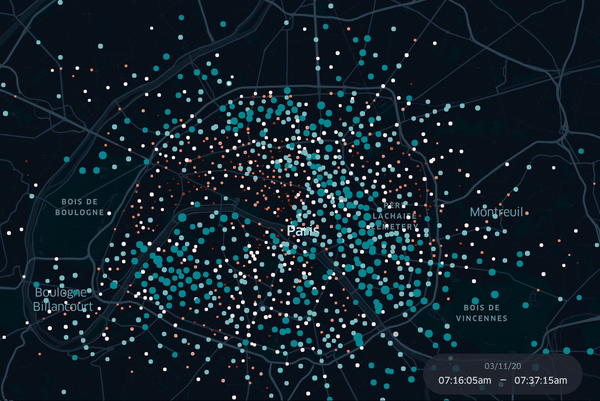

In [59]:
Image(filename="./visualization/wed_prelockdown_timelapse.gif",embed=True,width=850)

In [60]:
wed_lockdown_timelapse = df_activity_lockdown[df_activity_lockdown['weekday'] == 2]

In [61]:
wed_lockdown_timelapse.to_csv('wed_lockdown_timelapse.csv',index=False)

### Activity change per station during Wednesday 18th 2020 

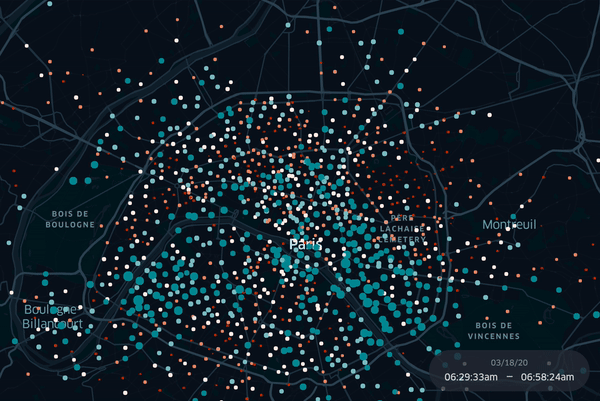

In [62]:
Image(filename="./visualization/wed_lockdown_timelapse.gif",embed=True,width=850)

## 3.6 How did the bike usage change over the entire period per arrondissement?

In [63]:
def percentageOfBikes(row):
    try:
        a = row.total_available_bikes 
        b = (row.total_available_bikes + row.free_stands) / 100.0
        c = 100 - (a / b)
    except ZeroDivisionError:
        c = 0
    return c 
    

In [64]:
df_activity["perc_bikes_usag"] = df_activity.apply(lambda row: percentageOfBikes(row), axis=1 )

In [65]:
df_activity["perc_bikes_usag"].head()

0     71.428571
1     76.923077
2     13.333333
3     65.000000
4    100.000000
Name: perc_bikes_usag, dtype: float64

In [66]:
grouped_date = df_activity.groupby(by=['station_id','postcode','date'])['perc_bikes_usag'].mean().reset_index()

In [67]:
grouped_date_2 = grouped_date.groupby(by=['postcode','date'])['perc_bikes_usag'].mean().reset_index()

In [68]:
#grouped_date_subset = grouped_date_2[(grouped_date_2['postcode'] == "75011") | (grouped_date_2['postcode'] == "75004") | (grouped_date_2['postcode'] == "75008")]

In [69]:
grouped_date_subset = grouped_date_2[(grouped_date_2['postcode'].str.contains("750"))]

In [70]:
fig = px.line(grouped_date_subset, x="date", y="perc_bikes_usag", color='postcode',title="Bike usage per day", labels={
                     "date": "Date",
                     "perc_bikes_usag": "% of bikes used"
                 })
fig.update_layout(xaxis = dict(tickmode = 'linear'))
fig.show()

## 4.Conclusion

**Research Questions:**

How many Velib bikes can we find in Paris and how are they distributed throughout the city?
- Total nb. of Stations: 1399
- Nb. of Stations (Paris): 977
- Highest nb. of bike slots per arrondissement: 3253 slots (15eme)
- Right bank: highest density => 2,9,8,11,4,1
- Left bank: higest density => 15,5,6


How did the bike usage change during lockdown?
- We can observe that on the prelockdown wednesday timeslots between 8-10am and 18-20pm are show the highest bike usage. This is propably related to the people commuting from or to work. 
- During lockdown, as expected we can see less activity during these rush hours and an overall decrease in the bike usage throughout the day.


Which stations gained vs. lost bikes between 8-10am on the first day of lockdown?
- Before lockdown it becomes very visible that people move from arrondissement where people life (outskirts) to the city centre (business arrondissements)
- during lockdown this behaviour is still visible but very reduced, there is still movement happening throughout the day but more scattered throughout the city. 

How did the bike usage change over the entire period per arrondissement?
=> For this we will compare especially the behaviour of the business center (8) to the outskirt arrondissement (20).

- 8eme: 
    - prelockdown => people move out during the weekend 
    - lockdown => less usage compared but increase weekend vs week
- 20eme: 
    - prelockdown => people used bike less during the weekend
    - lockdown => usage is declining, people chill or respect 1km rule


**Limitations of the analysis/dataset:**
- We don't know the number of total bikes available in the system
- We don't have information of biking behaviour (origin-destination) which could give us a better insight on the bike usage throughout Paris
- The dataset deals only with a time period of 2 weeks. For better accuracy more data/longer time periods would be interesting to analyse